<a href="https://colab.research.google.com/github/vibheshmodgil/vibhesh/blob/master/Copy_of_DriveCycle.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### 1. Importing the required libraries

In [ ]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
import scipy.signal as signal
from sklearn.cluster import KMeans
import random
from scipy.optimize import minimize
from scipy.optimize import differential_evolution
from collections import Counter
import math
from scipy import interpolate

#### 2. Creating a single excel file from all

In [ ]:
# # Set the path to the folder containing the Excel files
# folder_path = "C:\\Users\\vibhe\\OneDrive\\Desktop\\DriveCycle\\Raw Data\\Bhivesh\\Trips"

# # Set the name of the output Excel file
# output_file = "AllInOne_withAngle.xlsx"

# # Set the name of the columns to select from each Excel file
# column_name = ["Speed", "Elevation"]

# # Create an empty list to store the selected data
# data = []

# # Loop through all Excel files in the folder
# for file_name in os.listdir(folder_path):
#     if file_name.endswith(".xlsx") and not file_name.startswith("~$"):
#         # Read in the Excel file
#         file_path = os.path.join(folder_path, file_name)
#         df = pd.read_excel(file_path)

#         if column_name[0] in df.columns and column_name[1] in df.columns:
#             # Select the desired columns and append them to the data list
#             column_data = df[column_name]
# #             print(column_data)
#             data.append(column_data)

# # Concatenate the data into a single dataframe
# output_df = pd.concat(data).reset_index(drop=True)



Adding all other required feilds

In [ ]:
# output_df["hyp"] = (output_df['Speed'] + output_df['Speed'].shift(1)) / 2
# output_df.loc[0,"hyp"] = 0
# output_df["per"] = output_df['Elevation'].diff()
# output_df['angle'] = np.arcsin(output_df['per'] / output_df['hyp']) * 180 / np.pi
# output_df['angle'] = output_df['angle'].fillna(0)

output_df = pd.read_excel('output.xlsx')

### 3. Setting up the new dataframe and Filtering the data

In [ ]:
# Define the Butterworth filter parameters
order = 2
cutoff_frequency = 0.1 # in Hz

# Define the filter function
def butterworth_filter(data, order, cutoff_frequency, sampling_frequency):
    nyquist_frequency = 0.5 * sampling_frequency
    normalized_cutoff_frequency = cutoff_frequency / nyquist_frequency
    b, a = signal.butter(order, normalized_cutoff_frequency, btype='lowpass')
    filtered_data = signal.filtfilt(b, a, data)
    return filtered_data

# Apply the Butterworth filter to the Speed column
df_all = output_df
df_all = df_all[df_all['Speed'] > 0]
sampling_frequency = 1.0  # assumes unit time interval between samples
df_all['Filtered_speed'] = butterworth_filter(df_all['Speed'], order, cutoff_frequency, sampling_frequency)
order = 4
cutoff_frequency = 0.05 # in Hz
df_all['Filtered_angle'] = butterworth_filter(df_all['angle'], order, cutoff_frequency, sampling_frequency)
df_all['Filtered_speed']  = df_all['Speed'].rolling(window=3,center = True).mean()
df_all['Filtered_speed'] = df_all['Filtered_speed'].round(2)


<ipython-input-4-267b1eb79b7f>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_all['Filtered_speed'] = butterworth_filter(df_all['Speed'], order, cutoff_frequency, sampling_frequency)
<ipython-input-4-267b1eb79b7f>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_all['Filtered_angle'] = butterworth_filter(df_all['angle'], order, cutoff_frequency, sampling_frequency)
<ipython-input-4-267b1eb79b7f>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

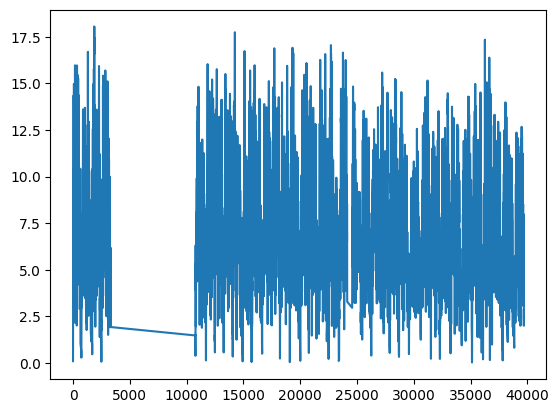

In [ ]:
plt.plot(df_all['Filtered_speed'])

Ploting the first 200 values to see wether the plot filter is working

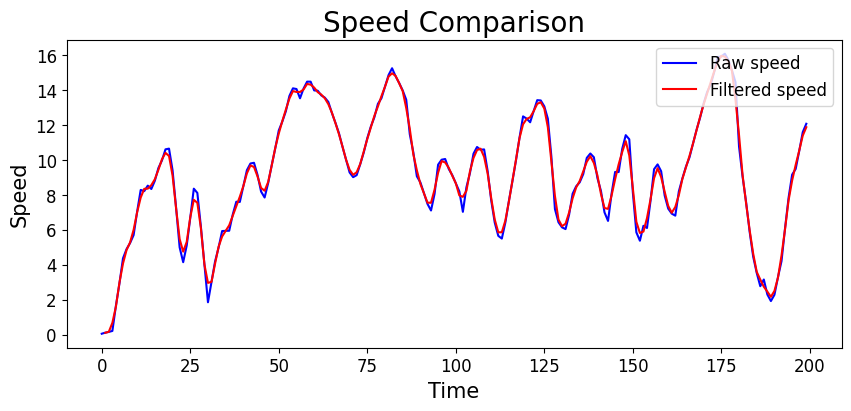

In [ ]:
# Create a new figure and axis
fig, ax = plt.subplots(figsize=(10, 4))

# Plot the two series
ax.plot(df_all['Speed'][:200], label="Raw speed", color='blue')
ax.plot(df_all['Filtered_speed'][:200], label="Filtered speed", color='red')

# Add a title and axis labels
ax.set_title("Speed Comparison", fontsize=20)
ax.set_xlabel("Time", fontsize=15)
ax.set_ylabel("Speed", fontsize=15)

# Add a legend
ax.legend(fontsize=12, loc='upper right')

# Adjust the font size of tick labels
ax.tick_params(axis='both', which='major', labelsize=12)

# Show the plot
plt.show()

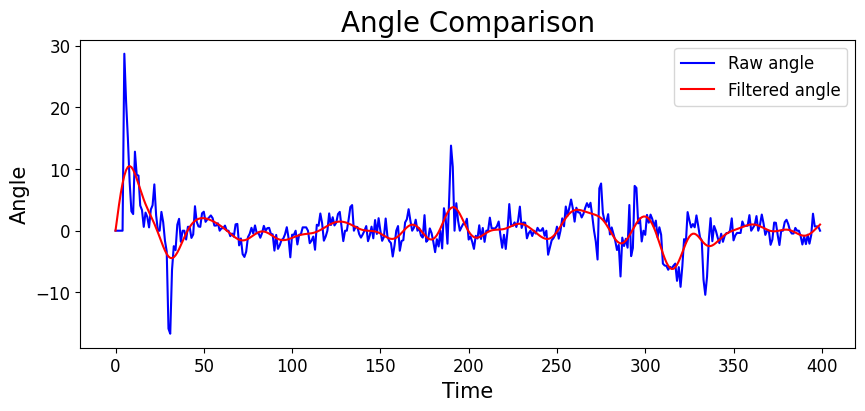

In [ ]:
# Create a new figure and axis
fig, ax = plt.subplots(figsize=(10, 4))

# Plot the two series
ax.plot(df_all['angle'][:400], label="Raw angle", color='blue')
ax.plot(df_all['Filtered_angle'][:400], label="Filtered angle", color='red')

# Add a title and axis labels
ax.set_title("Angle Comparison", fontsize=20)
ax.set_xlabel("Time", fontsize=15)
ax.set_ylabel("Angle", fontsize=15)

# Add a legend
ax.legend(fontsize=12, loc='upper right')

# Adjust the font size of tick labels
ax.tick_params(axis='both', which='major', labelsize=12)

# Show the plot
plt.show()

In [ ]:
df_all['acceleration'] = df_all['Filtered_speed'].diff()
df_all = df_all.dropna() # droping all the nan values
df_all = df_all.reset_index(drop = True) #The index should be reindexed after deleting the nan values

<ipython-input-8-966fcfc15801>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_all['acceleration'] = df_all['Filtered_speed'].diff()


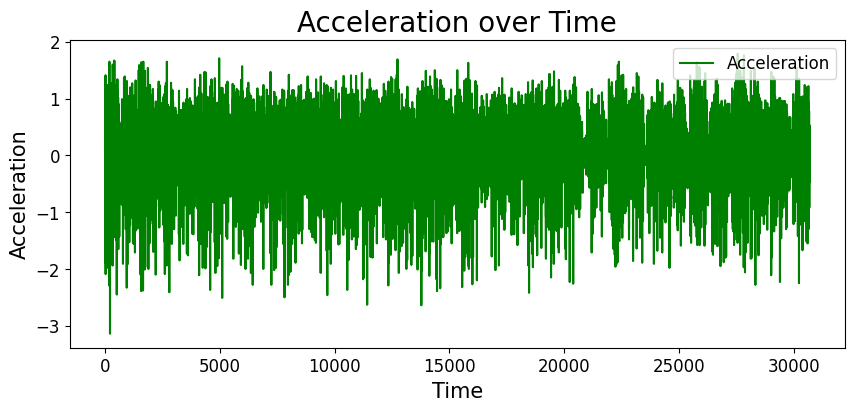

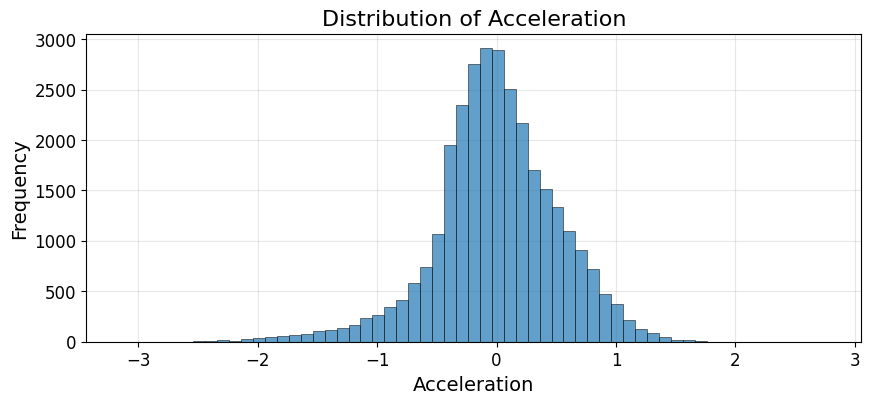

In [ ]:
# Create a new figure and axis
fig, ax = plt.subplots(figsize=(10, 4))

# Plot the acceleration series
ax.plot(df_all['acceleration'], label="Acceleration", color='green')

# Add a title and axis labels
ax.set_title("Acceleration over Time", fontsize=20)
ax.set_xlabel("Time", fontsize=15)
ax.set_ylabel("Acceleration", fontsize=15)

# Add a legend
ax.legend(fontsize=12, loc='upper right')

# Adjust the font size of tick labels
ax.tick_params(axis='both', which='major', labelsize=12)

# Show the plot
plt.show()


fig, ax = plt.subplots(figsize=(10,4))

ax.hist(df_all['acceleration'], bins=np.arange(df_all['acceleration'].min(), df_all['acceleration'].max()+1, 0.1), alpha=0.7, edgecolor='black', linewidth=0.5)

ax.set_xlabel('Acceleration', fontsize=14)
ax.set_ylabel('Frequency', fontsize=14)
ax.set_title('Distribution of Acceleration', fontsize=16)
ax.grid(True, alpha=0.3)
ax.set_axisbelow(True)
ax.tick_params(axis='both', labelsize=12)

plt.show()

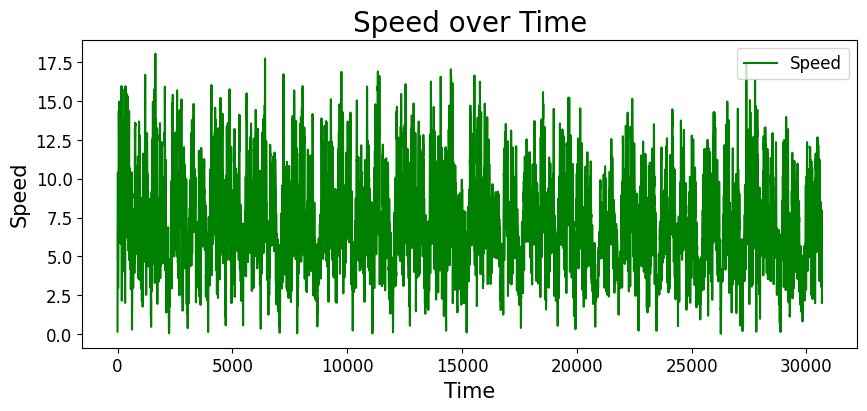

In [ ]:
# Create a new figure and axis
fig, ax = plt.subplots(figsize=(10, 4))

# Plot the speed series
ax.plot(df_all['Filtered_speed'], label="Speed", color='green')

# Add a title and axis labels
ax.set_title("Speed over Time", fontsize=20)
ax.set_xlabel("Time", fontsize=15)
ax.set_ylabel("Speed", fontsize=15)

# Add a legend
ax.legend(fontsize=12, loc='upper right')

# Adjust the font size of tick labels
ax.tick_params(axis='both', which='major', labelsize=12)

# Show the plot
plt.show()


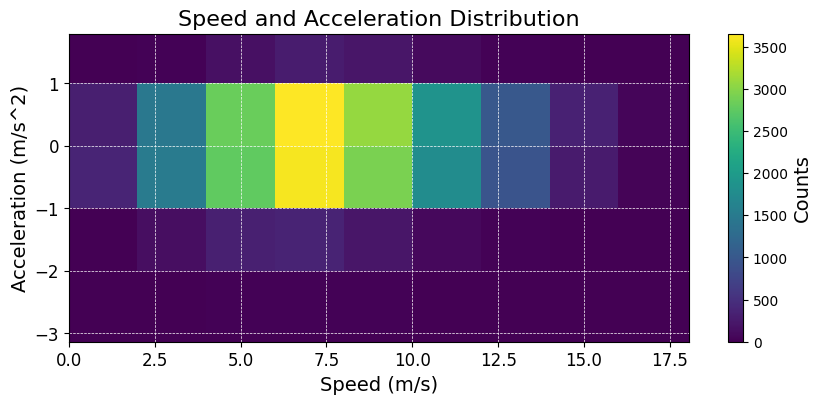

In [ ]:
# Define the data and bin sizes
speed_data = df_all['Filtered_speed']
acceleration_data = df_all['acceleration']
speed_bins = np.linspace(0, 80, 41)
acceleration_bins = np.linspace(-30, 30, 61)

# Create the 2D histogram
plt.figure(figsize=(10, 4))
hist = plt.hist2d(speed_data, acceleration_data, bins=[speed_bins, acceleration_bins], cmap=plt.cm.viridis)

# Add axis labels and a title
plt.xlabel('Speed (m/s)', fontsize=14)
plt.ylabel('Acceleration (m/s^2)', fontsize=14)
plt.title('Speed and Acceleration Distribution', fontsize=16)

# Add a grid
plt.grid(linestyle='--', linewidth=0.5, color='white')

# Set the colorbar label
cbar = plt.colorbar(hist[3])
cbar.ax.set_ylabel('Counts', fontsize=14)

# Set the tick label sizes
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Limit the x and y axis values to the maximum values of the data
plt.xlim(0, np.max(speed_data))
plt.ylim(np.min(acceleration_data), np.max(acceleration_data))

# Show the plot
plt.show()

In [ ]:
df_all = df_all[df_all['Speed'] > 0]
df_all

,Speed,Elevation,hyp,per,angle,Filtered_speed,Filtered_angle,acceleration
0,0.150,286.6,0.1295,1.9,0.000000,0.16,4.234122,0.06
1,0.207,287.4,0.1785,0.8,0.000000,0.67,6.091817,0.51
2,1.653,289.3,0.9300,1.9,0.000000,1.60,7.676363,0.93
3,2.932,290.4,2.2925,1.1,28.674007,2.98,8.929467,1.38
4,4.369,291.7,3.6505,1.3,20.861832,4.07,9.816027,1.09
...,...,...,...,...,...,...,...,...
30677,2.440,304.2,1.2200,-0.2,-9.435339,2.36,-4.581597,0.36
30678,3.002,303.9,2.7210,-0.3,-6.329934,2.89,-3.319706,0.53
30679,3.225,303.7,3.1135,-0.2,-3.683010,3.06,-1.676789,0.17
30680,2.955,303.5,3.0900,-0.2,-3.711059,2.88,0.278803,-0.18


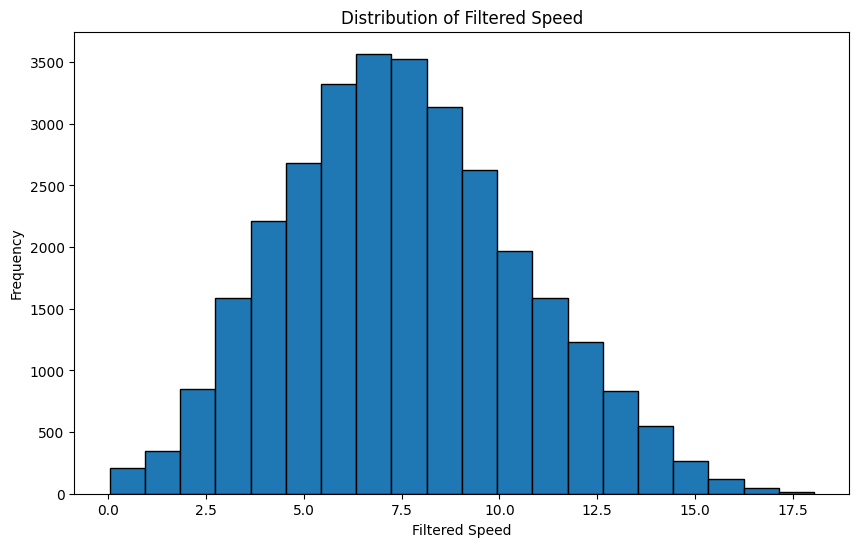

In [ ]:
# @title Distribution of Filtered Speed

import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
plt.hist(df_all['Filtered_speed'], bins=20, edgecolor='black')
plt.xlabel('Filtered Speed')
plt.ylabel('Frequency')
_ = plt.title('Distribution of Filtered Speed')

### 4. K means clustering for different speed bins

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

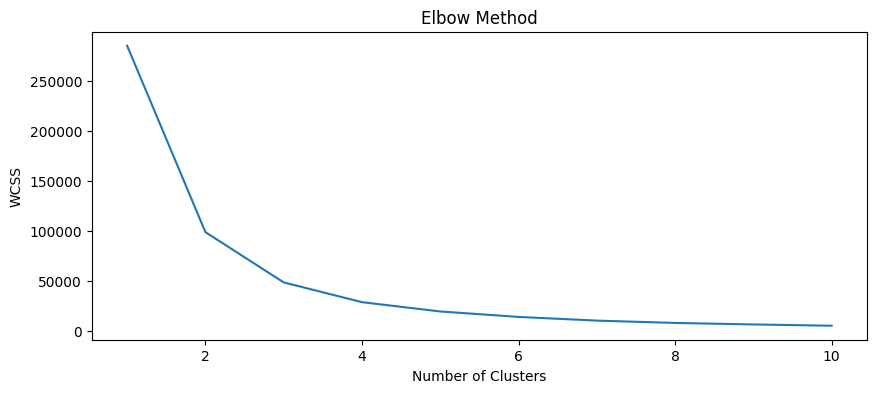

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


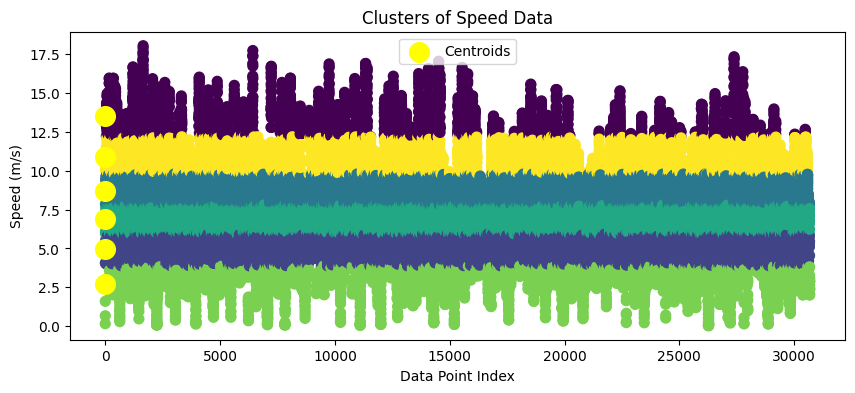

In [ ]:
# Reshape the speed data to a 2D array
X = np.array(df_all['Filtered_speed']).reshape(-1, 1)

# Determine the optimal number of clusters using the elbow method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.figure(figsize=(10, 4))
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()
x_indices = range(len(X))
# Train the K-means model
kmeans = KMeans(n_clusters=6, init='k-means++', random_state=42)
y_kmeans = kmeans.fit_predict(X)

# Get the speed ranges for each cluster
speed_ranges = []
for i in range(6):
    cluster_indices = np.where(y_kmeans == i)[0]
    min_speed = X[cluster_indices].min()
    max_speed = X[cluster_indices].max()
    speed_ranges.append((min_speed, max_speed))

# Create a bigger plot with all the clusters
fig, ax = plt.subplots(figsize=(10,4))
ax.scatter(x_indices, X, c=y_kmeans, s=50)
ax.scatter(range(len(kmeans.cluster_centers_)), kmeans.cluster_centers_[:, 0], s=200, c='yellow', label='Centroids')
ax.set_title('Clusters of Speed Data')
ax.set_xlabel('Data Point Index')
ax.set_ylabel('Speed (m/s)')
ax.legend()
plt.show()




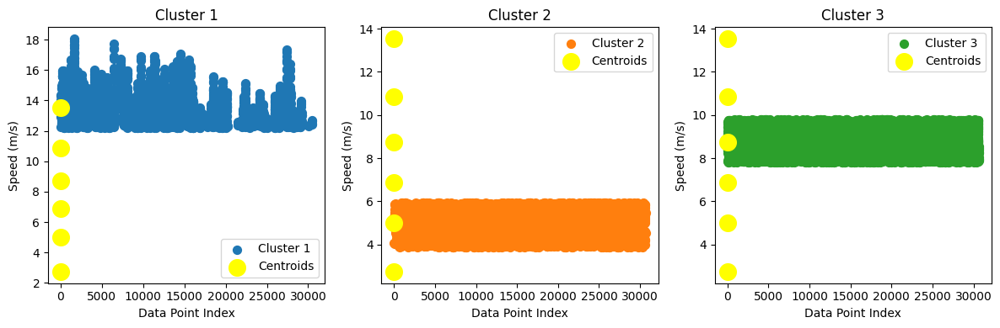

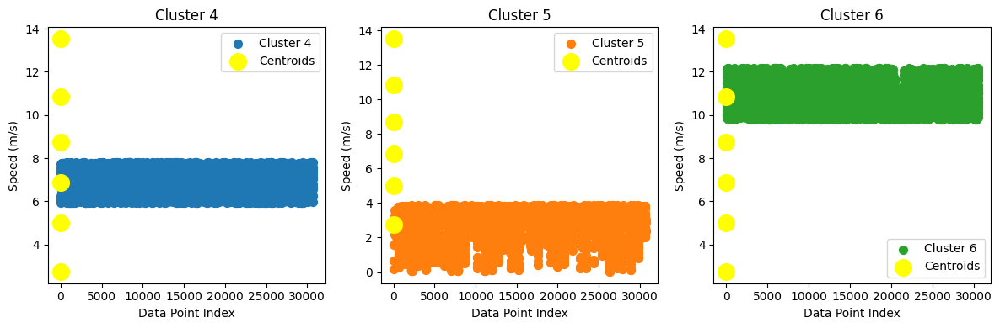

In [ ]:
# Create three rows of individual cluster plots
for i in range(0, len(np.unique(y_kmeans)), 3):
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    for j, ax in enumerate(axes.flat):
        cluster_num = i + j
        if cluster_num >= len(np.unique(y_kmeans)):
            ax.axis('off')
            continue
        ax.scatter([x_indices[k] for k in np.where(y_kmeans == cluster_num)[0]],
                   X[y_kmeans == cluster_num],
                   s=50,
                   c='C'+str(j),
                   label='Cluster '+str(cluster_num+1))
        ax.scatter(range(len(kmeans.cluster_centers_)),
                   kmeans.cluster_centers_[:, 0],
                   s=200,
                   c='yellow',
                   label='Centroids')
        ax.set_title('Cluster '+str(cluster_num+1))
        ax.set_xlabel('Data Point Index')
        ax.set_ylabel('Speed (m/s)')
        ax.legend()
    plt.tight_layout()
    plt.show()

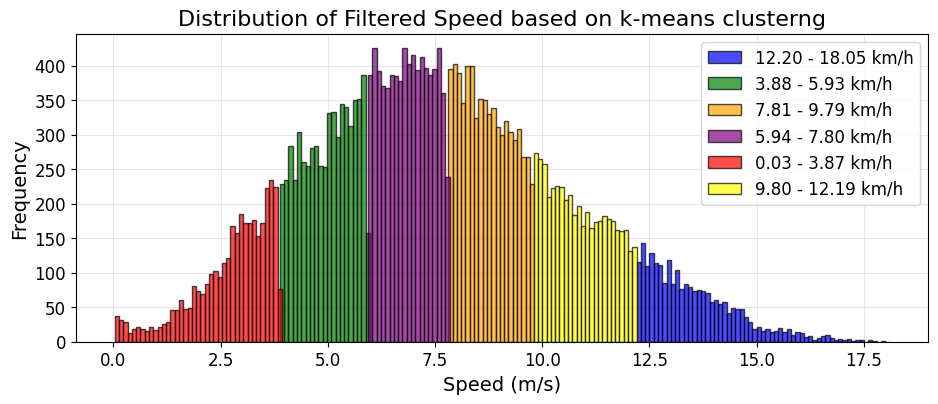

In [ ]:

colors = ['blue', 'green', 'orange', 'purple', 'red', 'yellow']

fig, ax = plt.subplots(figsize=(11,4))

for i, (start, end) in enumerate(speed_ranges):
    mask = (df_all['Filtered_speed'] >= start) & (df_all['Filtered_speed'] < end)
    ax.hist(df_all['Filtered_speed'][mask], bins=np.arange(start, end+0.1, 0.1), alpha=0.7, facecolor=colors[i], edgecolor='black', label=f'{start:.2f} - {end:.2f} km/h')

ax.set_xlabel('Speed (m/s)', fontsize=14)
ax.set_ylabel('Frequency', fontsize=14)
ax.set_title('Distribution of Filtered Speed based on k-means clusterng', fontsize=16)
ax.legend(fontsize=12)
ax.grid(True, alpha=0.3)
ax.set_axisbelow(True)
ax.tick_params(axis='both', labelsize=12)

plt.show()

In [ ]:
consecutive_zeros = df_all.eq(0).cumsum()
mask = consecutive_zeros.sub(consecutive_zeros.mask(df_all.ne(0)).ffill().fillna(0)).ge(1000)

# Delete rows with more than 1000 consecutive zeros
df = df_all.loc[~mask.any(axis=1)]

In [ ]:
df_all

,Speed,Elevation,hyp,per,angle,Filtered_speed,Filtered_angle,acceleration
0,0.150,286.6,0.1295,1.9,0.000000,0.16,4.234122,0.06
1,0.207,287.4,0.1785,0.8,0.000000,0.67,6.091817,0.51
2,1.653,289.3,0.9300,1.9,0.000000,1.60,7.676363,0.93
3,2.932,290.4,2.2925,1.1,28.674007,2.98,8.929467,1.38
4,4.369,291.7,3.6505,1.3,20.861832,4.07,9.816027,1.09
...,...,...,...,...,...,...,...,...
30677,2.440,304.2,1.2200,-0.2,-9.435339,2.36,-4.581597,0.36
30678,3.002,303.9,2.7210,-0.3,-6.329934,2.89,-3.319706,0.53
30679,3.225,303.7,3.1135,-0.2,-3.683010,3.06,-1.676789,0.17
30680,2.955,303.5,3.0900,-0.2,-3.711059,2.88,0.278803,-0.18


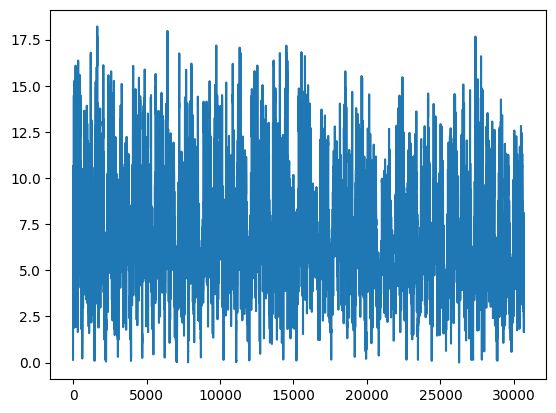

In [ ]:
plt.plot(df_all['Speed'])

In [ ]:
df_all

,Speed,Elevation,hyp,per,angle,Filtered_speed,Filtered_angle,acceleration
0,0.150,286.6,0.1295,1.9,0.000000,0.16,4.234122,0.06
1,0.207,287.4,0.1785,0.8,0.000000,0.67,6.091817,0.51
2,1.653,289.3,0.9300,1.9,0.000000,1.60,7.676363,0.93
3,2.932,290.4,2.2925,1.1,28.674007,2.98,8.929467,1.38
4,4.369,291.7,3.6505,1.3,20.861832,4.07,9.816027,1.09
...,...,...,...,...,...,...,...,...
30677,2.440,304.2,1.2200,-0.2,-9.435339,2.36,-4.581597,0.36
30678,3.002,303.9,2.7210,-0.3,-6.329934,2.89,-3.319706,0.53
30679,3.225,303.7,3.1135,-0.2,-3.683010,3.06,-1.676789,0.17
30680,2.955,303.5,3.0900,-0.2,-3.711059,2.88,0.278803,-0.18


### 5. Setting the modes for each point

In [ ]:

res = [0.13034643438602322, 0.0008539026537056405, 5, 0.7227359666430005]

a1 = res[0]
a2 = res[1]
n = res[2]
delta = res[3]

df_all['mode'] = "None"

# Create a new column called 'check_acc' that is True if the acceleration is greater than or equal to a2

df_all['check_acc'] = (df_all['acceleration'] >= a2)

# Initialize empty dictionaries to store information about acceleration and deacceleration snippets
dic_acc = {}
dic_dacc = {}

# Extract the check_acc and speed columns as lists
check_acc = df_all['check_acc'].tolist()[1:]
speed = df_all['Filtered_speed'].tolist()[1:]

# Initialize a counter variable
d = 0

# Iterate through each row of the check_acc and speed lists
for i in range(len(check_acc)):

    # If the current row indicates that acceleration is >= a2, increment the counter
    if check_acc[i]:
        d += 1

    # If the current row indicates that acceleration is < a2, and the previous n rows had acceleration >= a2,
    # and the speed has increased by more than delta over those n rows, add the acceleration snippet to dic_acc
    elif d > n and speed[i] - speed[i-d] > delta:
        dic_acc[i-d+1] = d
        d = 0

    # If the above conditions are not met, reset the counter
    else:
        d = 0

# Initialize the 'mode' column to None for all rows
print(dic_acc)

# For each acceleration snippet in dic_acc, set the 'mode' column to 'Acceleration'
ji = 0
for key, value in dic_acc.items():
    df_all.iloc[key:key+value, 3] = 'Acceleration'
    ji+=1

# For rows where acceleration is greater than a1, set the 'mode' column to 'Acceleration'
df_all.loc[df_all['acceleration'] > a1, 'mode'] = 'Acceleration'

# Repeat the above process for deacceleration
df_all['check_dacc'] = (df_all['acceleration'] <= -a2)
check_dacc = df_all['check_dacc'].tolist()[1:]
d = 0
for i in range(len(check_dacc)):
    if check_dacc[i]:
        d += 1
    elif d > n and speed[i-d] - speed[i] > delta:
        dic_dacc[i-d+1] = d
        d = 0
    else:
        d = 0

for key, value in dic_dacc.items():
    df_all.iloc[key:key+value, 3] = 'Deacceleration'
df_all.loc[df_all['acceleration'] < -a1, 'mode'] = 'Deacceleration'


# Set mode to 'cruise' for rows where acceleration is positive and mode is None
df_all.loc[(df_all['acceleration'] > 0) & (df_all['mode']=='None'), 'mode'] = 'cruise'


# Set mode to 'idle' for rows where acceleration is negative and mode is None
df_all.loc[(df_all['acceleration'] <= 0) & (df_all['mode']=='None'), 'mode'] = 'idle'

# Removing the columns that are not needed
df_all.drop(['check_acc', 'check_dacc'], axis=1, inplace=True)

{1: 16, 29: 12, 45: 8, 70: 11, 112: 11, 129: 8, 160: 14, 188: 15, 221: 11, 260: 6, 273: 7, 292: 8, 310: 7, 332: 13, 376: 10, 392: 7, 405: 8, 441: 10, 466: 11, 482: 11, 515: 10, 582: 7, 597: 8, 631: 24, 662: 10, 683: 14, 703: 7, 737: 6, 750: 9, 785: 8, 813: 7, 825: 6, 847: 6, 880: 10, 914: 10, 949: 12, 991: 6, 1018: 7, 1040: 15, 1062: 10, 1080: 7, 1096: 13, 1183: 24, 1222: 13, 1249: 14, 1272: 16, 1307: 9, 1344: 10, 1382: 6, 1390: 9, 1420: 8, 1455: 6, 1465: 6, 1495: 11, 1512: 10, 1529: 10, 1551: 13, 1580: 8, 1596: 8, 1624: 19, 1665: 11, 1693: 8, 1704: 10, 1736: 8, 1766: 7, 1790: 9, 1831: 9, 1864: 6, 1879: 6, 1892: 11, 1915: 10, 1948: 7, 1973: 6, 1982: 6, 1997: 8, 2035: 16, 2055: 8, 2082: 11, 2135: 7, 2147: 10, 2182: 11, 2198: 7, 2210: 7, 2248: 15, 2275: 19, 2298: 11, 2322: 9, 2347: 6, 2368: 21, 2397: 11, 2450: 9, 2474: 9, 2488: 6, 2510: 8, 2521: 8, 2542: 10, 2558: 7, 2577: 19, 2615: 6, 2630: 7, 2647: 14, 2689: 13, 2736: 9, 2767: 13, 2803: 18, 2838: 9, 2852: 11, 2873: 11, 2908: 10, 2986: 

<ipython-input-21-fdd3bf97191b>:48: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'Acceleration' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df_all.iloc[key:key+value, 3] = 'Acceleration'


In [ ]:
meanSpeed = df_all['Filtered_speed'].mean()
stdspeed = df_all['Filtered_speed'].std()
meanAcceleration = df_all['acceleration'].mean()
stdAcceleration = df_all['acceleration'].std()
countMode = df_all['mode'].value_counts()
accTime = (countMode["Acceleration"]/len(df_all))*100
daccTime = (countMode["Deacceleration"]/len(df_all))*100
idleTime = (countMode["idle"]/len(df_all))*100
cruiseTime = (countMode["cruise"]/len(df_all))*100

data_dict = {
    "meanSpeed": meanSpeed,
    "stdspeed": stdspeed,
    "meanAcceleration": meanAcceleration,
    "stdAcceleration": stdAcceleration,
    "countMode": countMode,
    "accTime": accTime,
    "daccTime": daccTime,
    "idleTime": idleTime,
    "cruiseTime": cruiseTime
}
print(data_dict)

{'meanSpeed': 7.550182517436934, 'stdspeed': 3.0511792122892034, 'meanAcceleration': 7.56143667296787e-05, 'stdAcceleration': 0.5231210422099255, 'countMode': mode
Deacceleration    11573
Acceleration      11548
idle               4118
cruise             3443
Name: count, dtype: int64, 'accTime': 37.637702887686594, 'daccTime': 37.71918388631771, 'idleTime': 13.42155009451796, 'cruiseTime': 11.221563131477739}


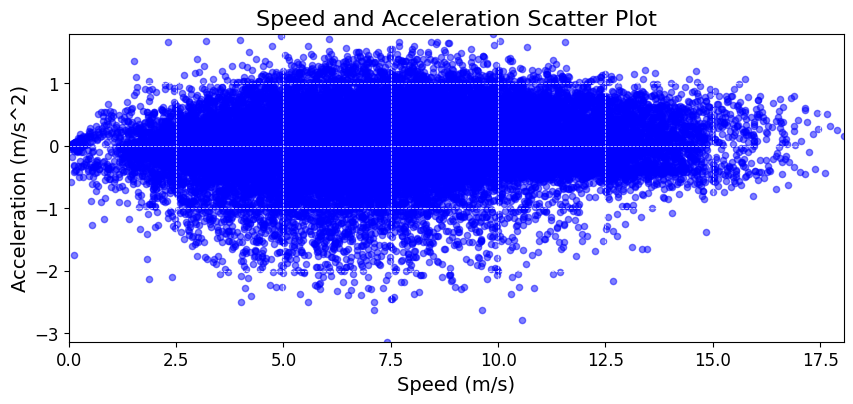

<ipython-input-23-af29110bcb9f>:42: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(speed_data, acceleration_data, s=30, c=mode_data.map(colors), cmap=cmap, alpha=0.5, edgecolors='none')


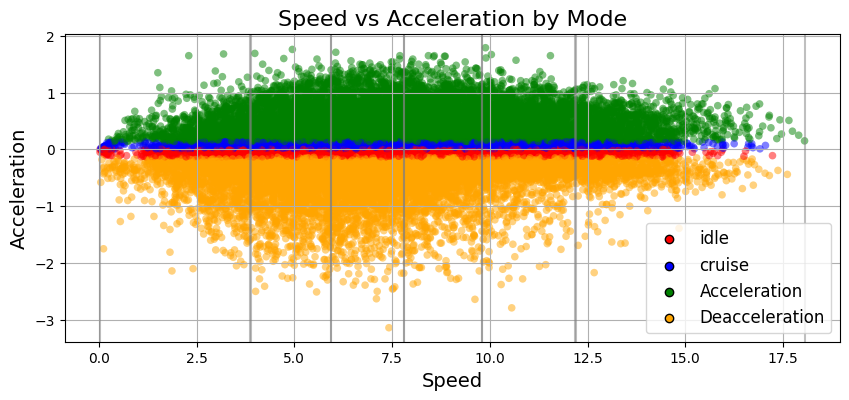

In [ ]:
# Define the data
speed_data = df_all['Filtered_speed']
acceleration_data = df_all['acceleration']

# Create the scatter plot
plt.figure(figsize=(10, 4))
plt.scatter(speed_data, acceleration_data, s=20, c='blue', alpha=0.5)

# Add axis labels and a title
plt.xlabel('Speed (m/s)', fontsize=14)
plt.ylabel('Acceleration (m/s^2)', fontsize=14)
plt.title('Speed and Acceleration Scatter Plot', fontsize=16)

# Add a grid
plt.grid(linestyle='--', linewidth=0.5, color='white')

# Set the tick label sizes
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Limit the x and y axis values to the maximum values of the data
plt.xlim(0, max(speed_data))
plt.ylim(min(acceleration_data), max(acceleration_data))

# Show the plot
plt.show()

from matplotlib.colors import ListedColormap

# Define colors for each mode category
colors = {'idle': 'red', 'cruise': 'blue', 'Acceleration': 'green', 'Deacceleration': 'orange'}

# Create a colormap to map mode category to colors
cmap = ListedColormap([colors[mode] for mode in df_all['mode'].unique()])

# Create data for scatter plot
speed_data = df_all['Filtered_speed']
acceleration_data = df_all['acceleration']
mode_data = df_all['mode']

fig, ax = plt.subplots(figsize=(10, 4))
plt.scatter(speed_data, acceleration_data, s=30, c=mode_data.map(colors), cmap=cmap, alpha=0.5, edgecolors='none')

# Add vertical lines for each speed range
for speed_range in speed_ranges:
    ax.axvline(x=speed_range[0], color='gray', alpha=0.5)
    ax.axvline(x=speed_range[1], color='gray', alpha=0.5)


# Add axis labels and a title
plt.xlabel('Speed', fontsize=14)
plt.ylabel('Acceleration', fontsize=14)
plt.title('Speed vs Acceleration by Mode', fontsize=16)

# Add grid
plt.grid(True)

# Add legend
handles = []
labels = []
for mode, color in colors.items():
    handles.append(plt.scatter([], [], c=color, label=mode, edgecolors='black'))
    labels.append(mode)

plt.legend(handles, labels, loc='lower right', fontsize=12)

plt.show()


####  6. Snippit creation

In [ ]:
# This res will have the snippit information with starting index ending index and the mode in which
# it is working

mode = df_all['mode'].tolist()
print(mode)
currMode = None
l = 0
r = 0
snippit = []
while r < len(mode):
    currMode = mode[l]
    r += 1
    while r < len(mode) and mode[r] == currMode :
        r += 1

    snippit.append([(l,r-1),currMode])
    l = r

print(snippit[:20],'..............')

['cruise', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'cruise', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'cruise', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'idle', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'Acceleration', 'idle', 'idle', 'Acceleration', 'Acceleration', 'idle', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Deacceleration', 'Deacce

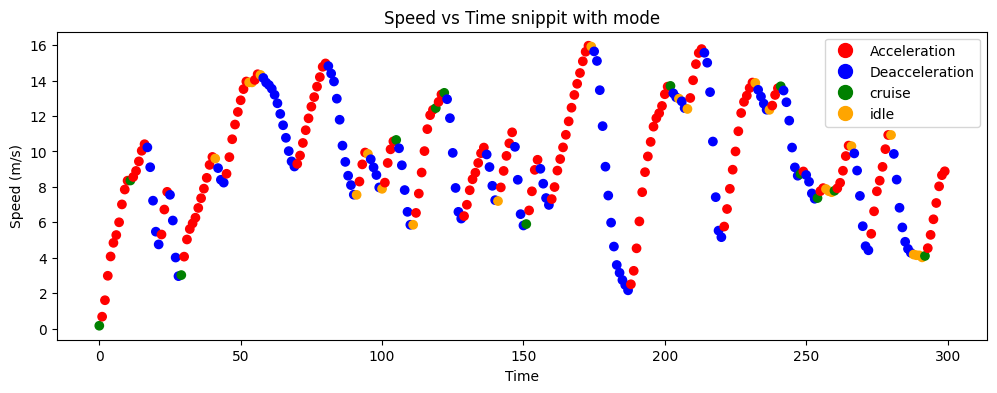

In [ ]:

# Set colors for each mode category
colors = {'Acceleration': 'red', 'Deacceleration': 'blue', 'cruise': 'green', 'idle': 'orange'}

# Create a list of colors for each data point based on the mode category
color_list = [colors[mode] for mode in df_all['mode']]

plt.figure(figsize=(12, 4))
# Plot the first 100 data points of the Speed data with different colors for each mode category
plt.scatter(df_all.index[:300], df_all['Filtered_speed'][:300], c=color_list[:300])

# Set the x-axis label and title
plt.xlabel('Time')
plt.title('Speed vs Time snippit with mode')

# Set the y-axis label
plt.ylabel('Speed (m/s)')

# Show the legend with the labels for each color
handles = [plt.plot([], [], color=colors[key], marker='o', ls="", markersize=10)[0] for key in colors]
plt.legend(handles, colors.keys())

plt.show()

#### 6. Transition Probability Matrix
This transition_mode_speed will contain the tansition of modes with respect to speed ranges required in transion probability matrix

In [ ]:
transition_mode_speed = {}
for interval in speed_ranges :
    starting_speed = interval[0]
    ending_speed = interval[1]
    transition_mode_speed[(starting_speed,ending_speed)] = []
    for i in range(len(snippit)-1):

        snip = snippit[i]
        ev = df_all['Filtered_speed'][snip[0][1]]

        if ev>=starting_speed and ev<ending_speed:
            transition_mode_speed[(starting_speed,ending_speed)].append((snip[1],snippit[i+1][1]))
transition_mode_speed

{(12.2, 18.05): [('Acceleration', 'idle'),
  ('idle', 'Acceleration'),
  ('Acceleration', 'idle'),
  ('idle', 'Deacceleration'),
  ('Acceleration', 'Deacceleration'),
  ('Acceleration', 'cruise'),
  ('cruise', 'Acceleration'),
  ('Acceleration', 'cruise'),
  ('cruise', 'Deacceleration'),
  ('Acceleration', 'idle'),
  ('idle', 'Deacceleration'),
  ('Acceleration', 'cruise'),
  ('cruise', 'Deacceleration'),
  ('Deacceleration', 'idle'),
  ('idle', 'Deacceleration'),
  ('Deacceleration', 'idle'),
  ('idle', 'Acceleration'),
  ('Acceleration', 'Deacceleration'),
  ('Acceleration', 'idle'),
  ('idle', 'Deacceleration'),
  ('Deacceleration', 'idle'),
  ('idle', 'Acceleration'),
  ('Acceleration', 'cruise'),
  ('cruise', 'Deacceleration'),
  ('Acceleration', 'idle'),
  ('idle', 'Deacceleration'),
  ('Deacceleration', 'cruise'),
  ('cruise', 'Acceleration'),
  ('Acceleration', 'idle'),
  ('idle', 'Deacceleration'),
  ('Acceleration', 'cruise'),
  ('cruise', 'Acceleration'),
  ('Acceleration', 

In [ ]:
transition_probability_matrix = {}
dic_modes = {'Acceleration':0, 'Deacceleration':1, 'cruise':2, 'idle':3}
modes = ['Acceleration', 'Deacceleration', 'cruise', 'idle']

for t in transition_mode_speed:

    # Initialize the transition probability matrix
    n_modes = len(modes)
    P = np.zeros((n_modes, n_modes))
    only_modes = transition_mode_speed[t]

    # Count the number of transitions between modes
    for i in range(len(only_modes)):
        row = dic_modes[only_modes[i][0]]
        col = dic_modes[only_modes[i][1]]
        P[row, col] += 1

    # Normalize the counts to get probabilities
    for i in range(n_modes):
        row_sum = np.sum(P[i, :])
        if row_sum > 0:
            P[i, :] /= row_sum
    transition_probability_matrix[t] = P

In [ ]:
transition_probability_matrix


{(12.2,
  18.05): array([[0.        , 0.26959248, 0.40752351, 0.32288401],
        [0.13684211, 0.        , 0.17894737, 0.68421053],
        [0.28947368, 0.45263158, 0.        , 0.25789474],
        [0.15533981, 0.68932039, 0.15533981, 0.        ]]),
 (3.88,
  5.93): array([[0.        , 0.11111111, 0.5993266 , 0.28956229],
        [0.33597464, 0.        , 0.23930269, 0.42472266],
        [0.57549234, 0.11159737, 0.        , 0.31291028],
        [0.34448819, 0.36220472, 0.29330709, 0.        ]]),
 (7.81,
  9.79): array([[0.        , 0.185     , 0.46      , 0.355     ],
        [0.10204082, 0.        , 0.21428571, 0.68367347],
        [0.35306554, 0.28964059, 0.        , 0.35729387],
        [0.15034965, 0.61363636, 0.23601399, 0.        ]]),
 (5.94,
  7.8): array([[0.        , 0.1996008 , 0.52295409, 0.27744511],
        [0.23758865, 0.        , 0.23404255, 0.52836879],
        [0.50524476, 0.1958042 , 0.        , 0.29895105],
        [0.27227723, 0.47194719, 0.25577558, 0.        ]]),


In [ ]:
next_mode_dict = {}
for speed_interval in transition_probability_matrix:

    next_mode_dict[speed_interval] = {}

    for i,s in enumerate(modes):

        next_mode_dict[speed_interval][s] = modes[transition_probability_matrix[speed_interval][i].argmax()]


NameError: name 'transition_probability_matrix' is not defined

In [ ]:
next_mode_dict # It will have the information about the transiton of mode based on current speed and curent mode

{(12.2, 18.05): {'Acceleration': 'cruise',
  'Deacceleration': 'idle',
  'cruise': 'Deacceleration',
  'idle': 'Deacceleration'},
 (3.88, 5.93): {'Acceleration': 'cruise',
  'Deacceleration': 'idle',
  'cruise': 'Acceleration',
  'idle': 'Deacceleration'},
 (7.81, 9.79): {'Acceleration': 'cruise',
  'Deacceleration': 'idle',
  'cruise': 'idle',
  'idle': 'Deacceleration'},
 (5.94, 7.8): {'Acceleration': 'cruise',
  'Deacceleration': 'idle',
  'cruise': 'Acceleration',
  'idle': 'Deacceleration'},
 (0.03, 3.87): {'Acceleration': 'cruise',
  'Deacceleration': 'idle',
  'cruise': 'Acceleration',
  'idle': 'cruise'},
 (9.8, 12.19): {'Acceleration': 'cruise',
  'Deacceleration': 'idle',
  'cruise': 'idle',
  'idle': 'Deacceleration'}}

In [ ]:
final = {}
modes = ['Acceleration', 'Deacceleration', 'cruise', 'idle']
for i in set(modes):
    final[i] = {}
filtered_speed = df_all['Filtered_speed']

for snip in snippit:
    mode_of_snnipit = snip[1]
    start_index = snip[0][0]
    end_index = snip[0][1]
    starting_speed = filtered_speed[start_index]
    ending_speed = filtered_speed[end_index]

    if starting_speed not in final[mode_of_snnipit]:
        final[mode_of_snnipit][starting_speed] = []

    final[mode_of_snnipit][starting_speed].append([(start_index,end_index),ending_speed])

In [ ]:
final

{'cruise': {0.16: [[(0, 0), 0.16], [(3947, 3949), 0.32]],
  8.36: [[(11, 11), 8.36],
   [(11587, 11588), 8.44],
   [(17766, 17768), 8.45],
   [(26621, 26621), 8.36]],
  3.02: [[(29, 29), 3.02]],
  10.65: [[(105, 105), 10.65], [(20020, 20020), 10.65]],
  12.45: [[(119, 119), 12.45]],
  13.31: [[(122, 122), 13.31]],
  5.9: [[(151, 151), 5.9], [(16619, 16620), 5.95]],
  13.7: [[(202, 202), 13.7]],
  13.68: [[(241, 241), 13.68], [(12539, 12539), 13.68]],
  8.73: [[(248, 248), 8.73],
   [(9841, 9841), 8.73],
   [(10103, 10103), 8.73],
   [(24756, 24756), 8.73]],
  7.37: [[(254, 254), 7.37],
   [(11069, 11070), 7.41],
   [(20080, 20080), 7.37],
   [(30365, 30365), 7.37]],
  7.78: [[(260, 260), 7.78], [(9429, 9429), 7.78], [(24278, 24279), 7.8]],
  4.1: [[(292, 292), 4.1],
   [(3995, 3996), 4.18],
   [(15113, 15113), 4.1],
   [(21370, 21372), 4.19],
   [(21782, 21783), 4.19]],
  7.19: [[(310, 310), 7.19], [(1071, 1071), 7.19], [(13836, 13837), 7.28]],
  9.8: [[(316, 316), 9.8],
   [(5171, 517

### 8. Drive Cycle Generation
1. First we have to find all the snnipits that starts with zero speed
and then choose randomly from it
2. For the sake of simplicity we will choose the idle one in the starting
3. Depending upon the speed and current mode the next mode of opreation is selected
4. Now after this we will find the next snnipits which have the mode as that of the next mode slected and its starting speed lies within the desired range after the ending of last snnipit

In [ ]:
def driveCycle(tol):
    drivecycle = [] # This will store the drive cycle information
    elevation = []
    mode = []


    current_mode = 'idle' # Selecting the first mode for the first snippit
    contender_snippit = final[current_mode][0.1] # Chooosing the starting snnipit from the idle mode that had the starting speed zero
    randomly_choosen_snnipit = random.choice(contender_snippit) # Randomly choose the starting snnipit

    # Adding the speed valuesof the snnipit to the drivecycle choosen
    for i in range(randomly_choosen_snnipit[0][0],randomly_choosen_snnipit[0][1]+1):
        drivecycle.append(df_all['Filtered_speed'][i])
        elevation.append(df_all['angle'][i])
        mode.append(current_mode)
    ending_speed_of_snnipit = randomly_choosen_snnipit[1]
    # Now we have to check the ending speed of the snnipit lies within what class of the speed
    for tup in speed_ranges:
        if ending_speed_of_snnipit >= tup[0] and ending_speed_of_snnipit < tup[1]:
            speed_class = tup
    # Now according to the speed class we will select the next mode of opreation
    next_mode = next_mode_dict[speed_class][current_mode]

    for x in range(400):
        tolerance = tol
        min_allowed_speed = ending_speed_of_snnipit-tolerance
        max_allowed_speed = ending_speed_of_snnipit+tolerance
        contender_snippit = []
        for s in final[next_mode]:
            if s>min_allowed_speed and s<max_allowed_speed:
                contender_snippit.extend(final[next_mode][round(s, 2)])

        randomly_choosen_snnipit = random.choice(contender_snippit) # Randomly choose the starting snnipit


        # Adding the speed valuesof the snnipit to the drivecycle choosen
        for i in range(randomly_choosen_snnipit[0][0],randomly_choosen_snnipit[0][1]+1):
            drivecycle.append(df_all['Filtered_speed'][i])
            elevation.append(df_all['angle'][i])
            mode.append(next_mode)
        ending_speed_of_snnipit = randomly_choosen_snnipit[1]

        # Now we have to check the ending speed of the snnipit lies within what class of the speed
        for tup in speed_ranges:
            if ending_speed_of_snnipit >= tup[0] and ending_speed_of_snnipit < tup[1]:
                speed_class = tup
        next_mode = next_mode_dict[speed_class][next_mode]
        if (len(drivecycle) >= 1500) and (ending_speed_of_snnipit <= 1 ) :
            break

#         final[next_mode] = [lst for lst in final[next_mode] if not np.array_equal(lst, randomly_choosen_snnipit)]
    # plot the drive cycle
# increase figure size
    fig, ax = plt.subplots(figsize=(10, 4))

    # plot the data
    ax.plot(drivecycle, color='blue', label='Drive Cycle')

    # add labels and title
    ax.set_xlabel('Time (s)', fontsize=14)
    ax.set_ylabel('Speed (m/s)', fontsize=14)
    ax.set_title('Drive Cycle', fontsize=16)

    # customize the appearance of the plot
    ax.grid(color='lightgray', linestyle='--', linewidth=0.5)
    max_speed = int(max(drivecycle)) + 10
    ax.set_ylim(0, max_speed)
    ax.set_xticks(range(0, len(drivecycle) + 1, 200))
    ax.set_yticks(range(0, max_speed + 1, 10))

    # add legend
    ax.legend(fontsize=12)

    # show the plot
    plt.show()
    return drivecycle , elevation,mode

    # set the path where you want to save the image


### Creating the number of cycles and and storing the relevant information

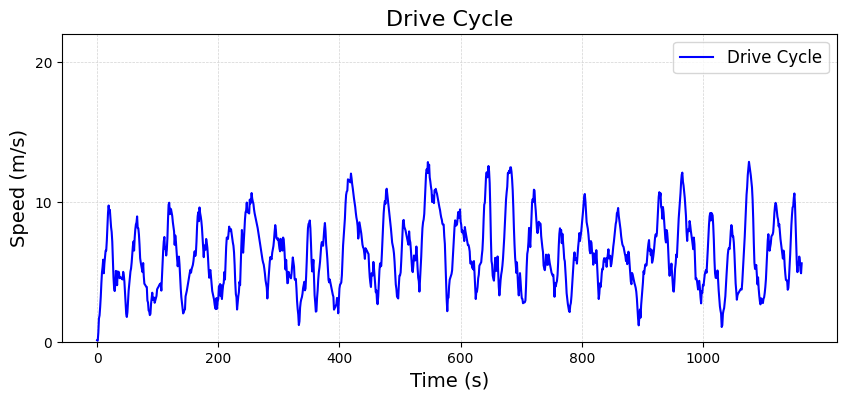

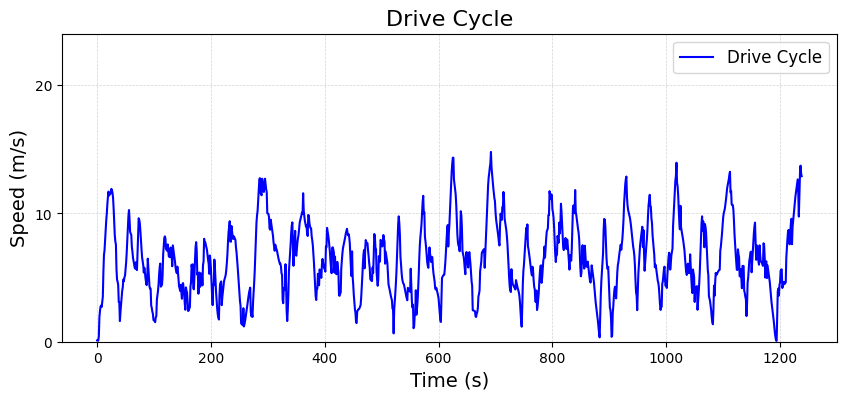

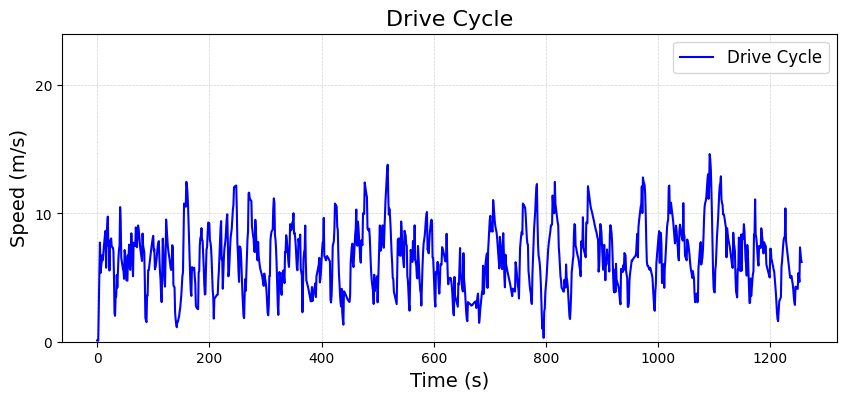

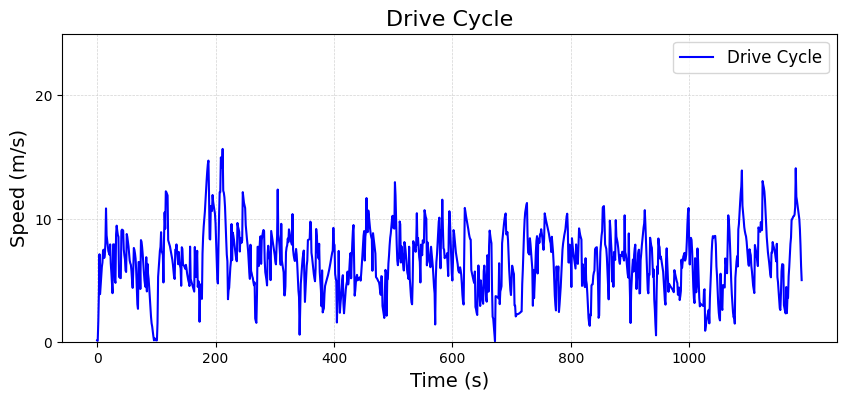

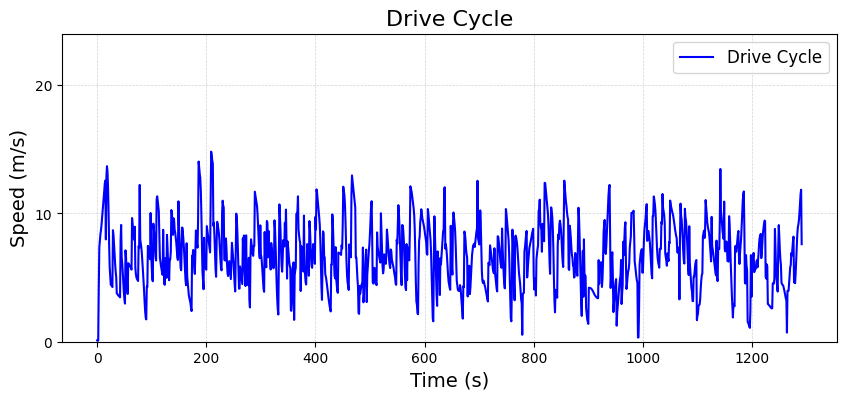

...

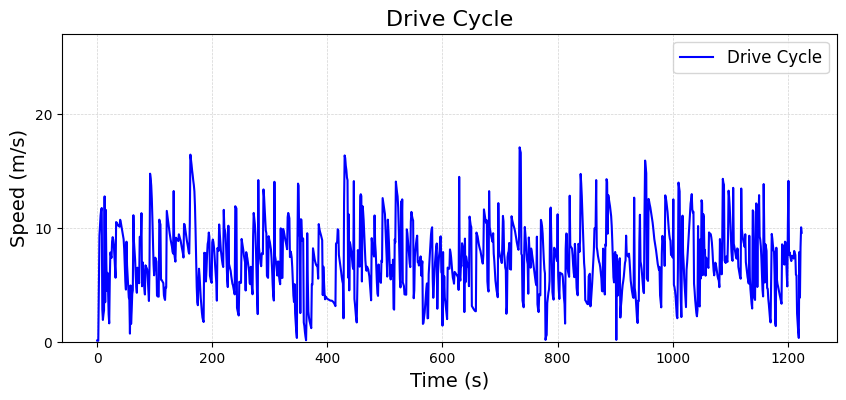

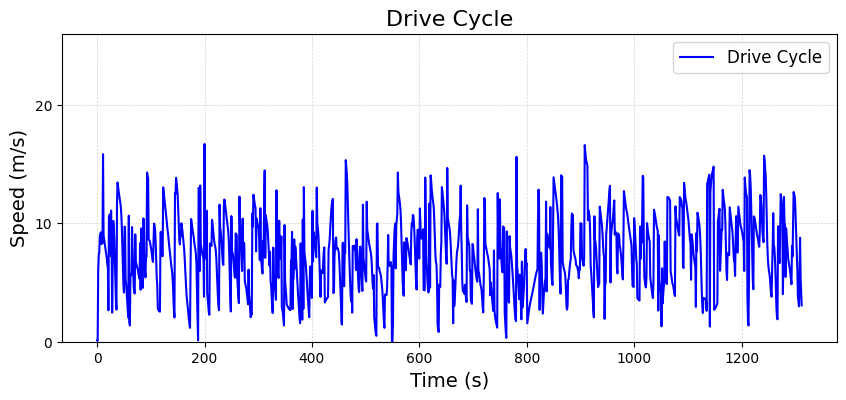

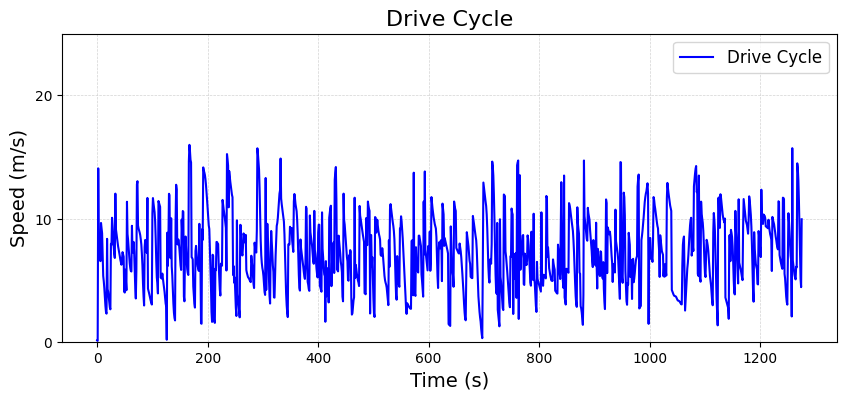

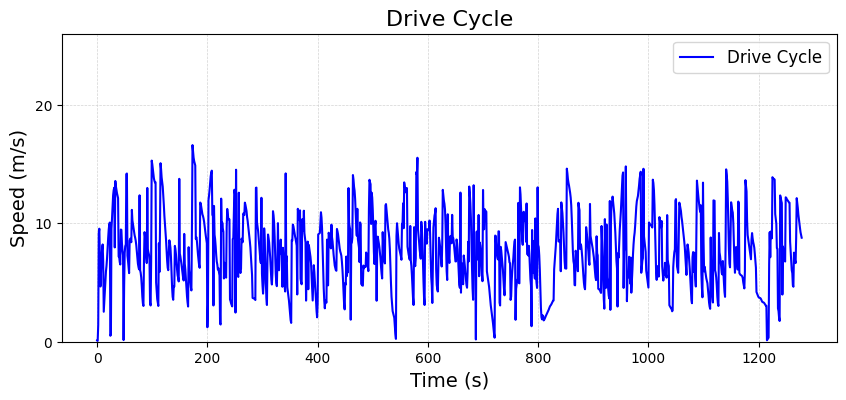

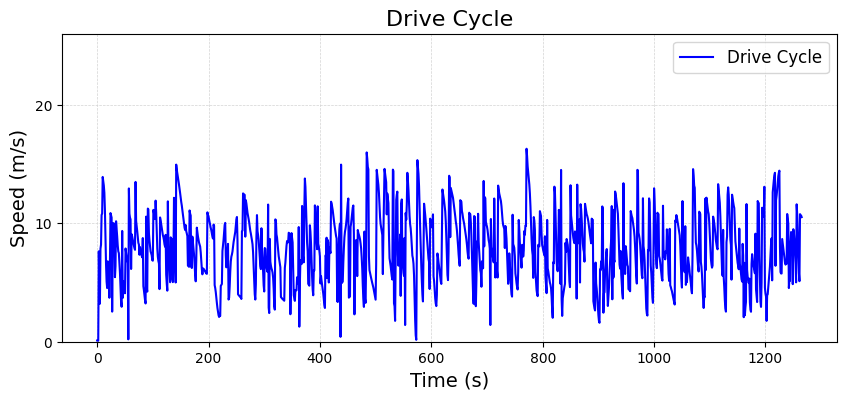

In [ ]:
candidateDriveCycles = []
elevationDriveCycles = []
modeDriveCycles = []
check = [0.05, 0.08, 0.1]
for x in check :
    for i in range(100):
        try :
            x , y, z = driveCycle(i)
            candidateDriveCycles.append(x)
            elevationDriveCycles.append(y)
            modeDriveCycles.append(z)
        except :
            pass

### 9. Selecting the best drivecycle out of all generated one

In [ ]:
def testing(observed_data,candidate_cycle,mode_cycle) :

    value_counts_dc = Counter(mode_cycle)

    for s in value_counts_dc:
            value_counts_dc[s] = value_counts_dc[s]/len(mode_cycle)


    od_list = observed_data["mode"].tolist()
    value_counts_od = Counter(od_list)

    for s in value_counts_od:
            value_counts_od[s] = value_counts_od[s]/len(od_list)

    add = 0

    for s in value_counts_od:

        add+=abs(value_counts_od[s]-value_counts_dc[s])


    # Define the speed and acceleration resolutions
    speed_resolution = 1  # mph
    acceleration_resolution = 1  # mph/s

    # Compute the fraction of time spent at each speed-acceleration pair in the candidate cycle
    counts_candidate = np.zeros((121, 121))
    for i in range(len(candidate_cycle) - 1):
        a = ((candidate_cycle[i+1] - candidate_cycle[i]) / acceleration_resolution)
        v = candidate_cycle[i+1] / speed_resolution
        counts_candidate[int(a), int(v)] += 1
    fractions_candidate = counts_candidate / len(candidate_cycle)
    # print(fractions_candidate)
    # Compute the fraction of time spent at each speed-acceleration pair in the observed data
    counts_observed = np.zeros((121, 121))
    for i in range(len(observed_data) - 1):
        a = df_all['acceleration'][i] / acceleration_resolution
        v = observed_data['Filtered_speed'][i+1] / speed_resolution
        counts_observed[int(a), int(v)] += 1
    fractions_observed = counts_observed / len(observed_data)
    # print(fractions_observed)
    # Compute the SAFDdiff
    SAFDdiff = np.sum(np.abs(fractions_candidate - fractions_observed))
    final = add + SAFDdiff
    # print("final: ",final)
    return SAFDdiff, add




In [ ]:
SAFDiff_val = []
mode_diff_val = []
comb = []
for i in range(len(candidateDriveCycles)) :
    out = testing(df_all,candidateDriveCycles[i],modeDriveCycles[i])
    SAFDiff_val.append(out[0])
    mode_diff_val.append(out[1])
    comb.append(out[0]+out[1])


7.550182517436934 6.357932454695217 6.357932454695217 6.357932454695217
3.0511792122892034 2.607674030082641 2.607674030082641 2.607674030082641


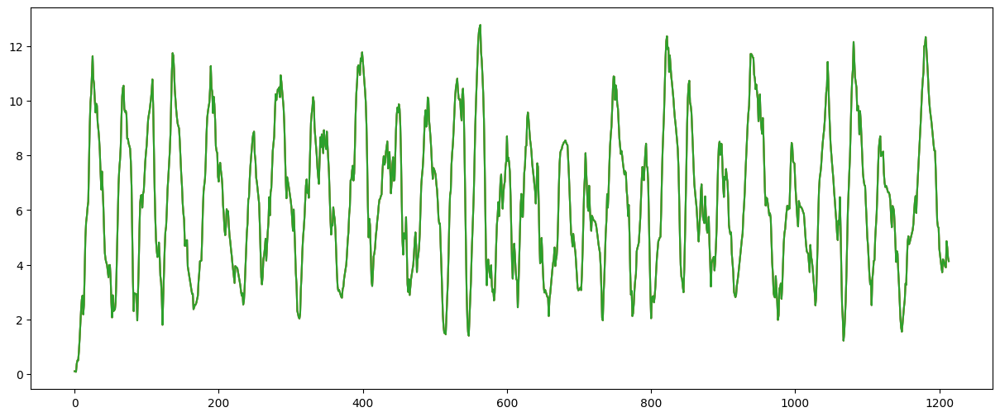

In [ ]:
SAFDiff_cycle = candidateDriveCycles[SAFDiff_val.index(min(SAFDiff_val))]
SAFDiff_cycle_angle = elevationDriveCycles[SAFDiff_val.index(min(SAFDiff_val))]
mode_diff_cycle = candidateDriveCycles[mode_diff_val.index(min(mode_diff_val))]
mode_diff_cycle_angle = elevationDriveCycles[mode_diff_val.index(min(mode_diff_val))]
comb_cycle = candidateDriveCycles[comb.index(min(comb))]
comb_angle = elevationDriveCycles[comb.index(min(comb))]
# Mean of the driveCycles
mean_observed_data = df_all['Filtered_speed'].mean()
mean_SADiff = sum(SAFDiff_cycle) / len(SAFDiff_cycle)
mean_mode_diff = sum(mode_diff_cycle) / len(mode_diff_cycle)
mean_comb = sum(comb_cycle) / len(comb_cycle)
print(mean_observed_data,mean_SADiff,mean_mode_diff,mean_comb)
# calculate the standard deviation
std_dev_observed_data = df_all['Filtered_speed'].std()
std_dev_SADiff = math.sqrt(sum([(x - mean_SADiff)**2 for x in SAFDiff_cycle]) / len(SAFDiff_cycle))
std_dev_mode_diff = math.sqrt(sum([(x - mean_mode_diff)**2 for x in mode_diff_cycle]) / len(mode_diff_cycle))
std_dev_comb = math.sqrt(sum([(x - mean_comb)**2 for x in comb_cycle]) / len(comb_cycle))
print(std_dev_observed_data,std_dev_SADiff,std_dev_mode_diff,std_dev_comb)

plt.figure(figsize = (15,6))
plt.plot(SAFDiff_cycle)
plt.plot(mode_diff_cycle)
plt.plot(comb_cycle)
plt.show()

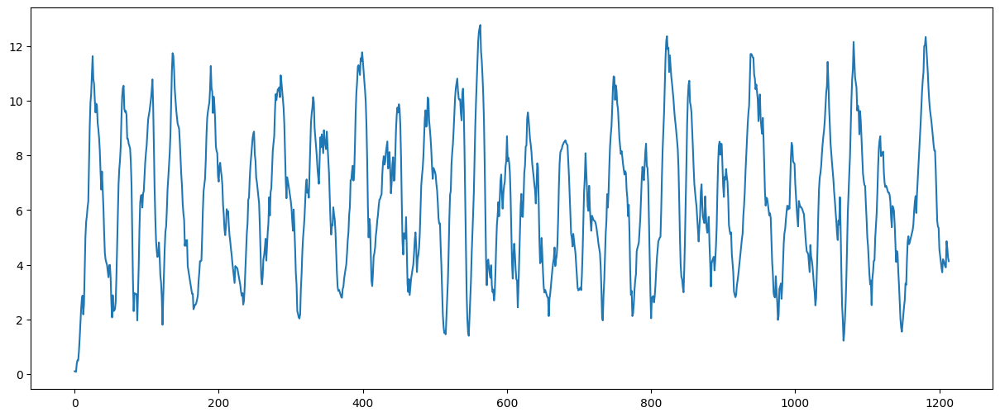

In [ ]:
plt.figure(figsize = (15,6))
plt.plot(SAFDiff_cycle)

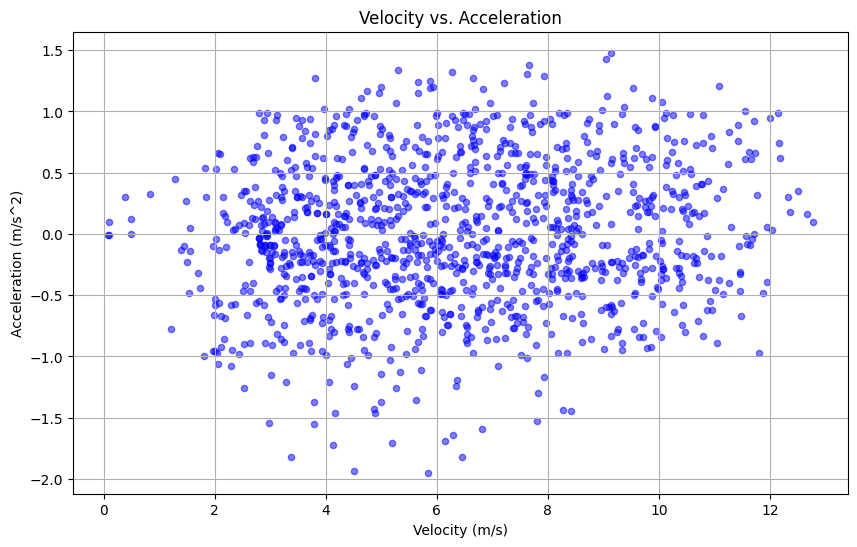

In [ ]:
# prompt: This is the list of velocity data per second plot the scatter plot of velocity vs acceleration out of it

# Calculate acceleration (approximate using finite differences)
acceleration = np.diff(comb_cycle, prepend=0)

# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(comb_cycle, acceleration, s=20, c='blue', alpha=0.5)
plt.xlabel('Velocity (m/s)')
plt.ylabel('Acceleration (m/s^2)')
plt.title('Velocity vs. Acceleration')
plt.grid(True)
plt.show()


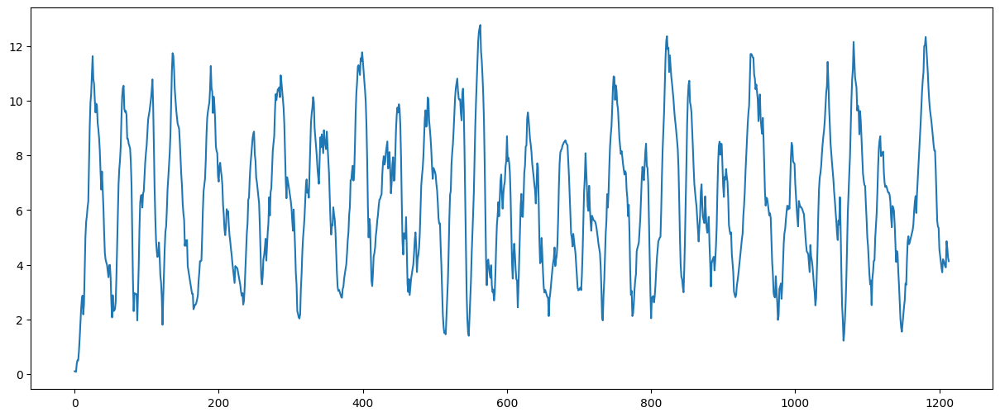

In [ ]:
plt.figure(figsize = (15,6))
plt.plot(mode_diff_cycle)

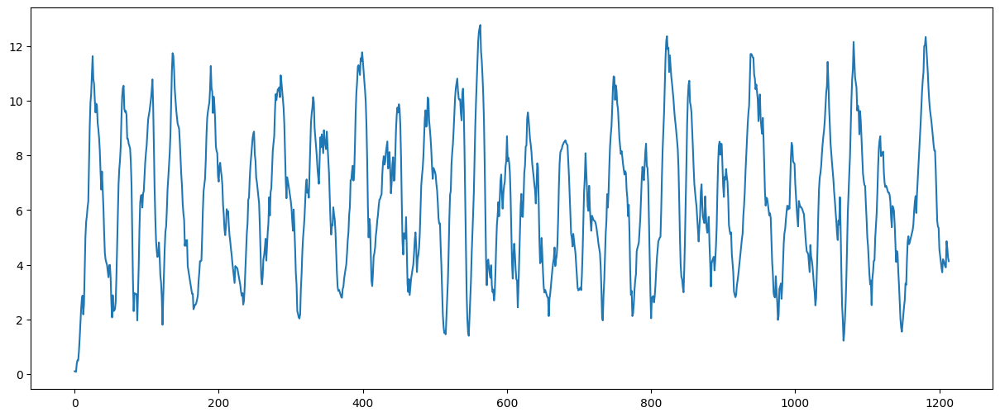

In [ ]:
plt.figure(figsize = (15,6))
plt.plot(comb_cycle)

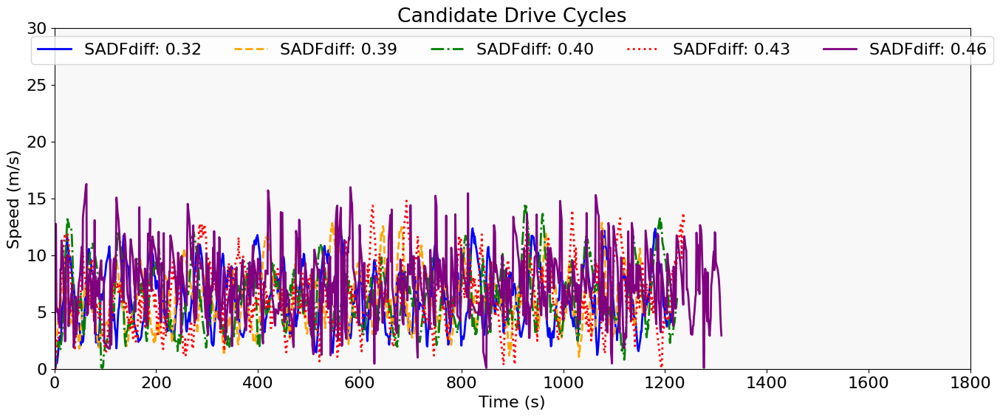

In [ ]:

def min_n_values_with_index(lst, n):
    # Sort the list and get the indices of the sorted list
    sorted_indices = sorted(range(len(lst)), key=lambda k: lst[k])
    # Return the first n indices and their corresponding values
    return [(sorted_indices[i], lst[sorted_indices[i]]) for i in range(n)]

x = min_n_values_with_index(SAFDiff_val,5)
plt.figure(figsize=(16, 6))


# Set the font size of the axis labels and title
plt.rcParams.update({'font.size': 16})

# Set the colors and styles of the plot lines
colors = ['blue', 'orange', 'green', 'red', 'purple']
styles = ['-', '--', '-.', ':', '-']
for i, idx in enumerate(x):
    plt.plot(candidateDriveCycles[idx[0]], label=f"SADFdiff: {idx[1]:.2f}", color=colors[i%5], linestyle=styles[i%5], linewidth=2)

# Set the limits and ticks of the x and y axes
plt.xlim(0, 1800)
plt.xticks(range(0, 1801, 200))
plt.ylim(0, 30)
plt.yticks(range(0, 31, 5))

# Set the legend label and its position
plt.legend(ncol=5, loc='upper center')

# Set the background color of the plot
plt.gca().set_facecolor('#F8F8F8')

# Set the title and labels of the x and y axes
plt.title('Candidate Drive Cycles')
plt.xlabel('Time (s)')
plt.ylabel('Speed (m/s)')

# Save the plot as a PNG image
plt.savefig('candidate_drive_cycles.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()



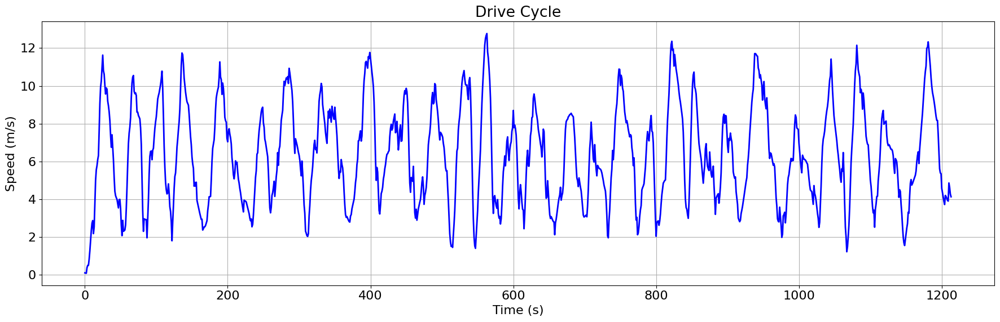

In [ ]:
plt.figure(figsize=(18, 6))
# Increase the font size of the axis labels and title
plt.rcParams.update({'font.size': 16})

# Set the color of the plot line and increase its thickness
plt.plot(mode_diff_cycle, color='blue', linewidth=2)

# Add a grid to the plot
plt.grid()

# Set the legend label and its position

plt.title('Drive Cycle')
plt.xlabel('Time (s)')
plt.ylabel('Speed (m/s)')

# Adjust the spacing of the subplots
plt.tight_layout()


# Show the plot
plt.show()


# DriveCycle Analysis

In [ ]:
df = pd.DataFrame({'Speed': SAFDiff_cycle})

# convert the 'Speed [km/h]' column to km/s
df['Speed [km/h]'] = df['Speed']*18/5

# add a column with time values
df['Time [s]'] = pd.Series(range(len(comb_cycle)))

print(df)

      Speed  Speed [km/h]  Time [s]
0      0.10         0.360         0
1      0.09         0.324         1
2      0.08         0.288         2
3      0.38         1.368         3
4      0.50         1.800         4
...     ...           ...       ...
1209   3.90        14.040      1209
1210   4.86        17.496      1210
1211   4.63        16.668      1211
1212   4.27        15.372      1212
1213   4.13        14.868      1213

[1214 rows x 3 columns]


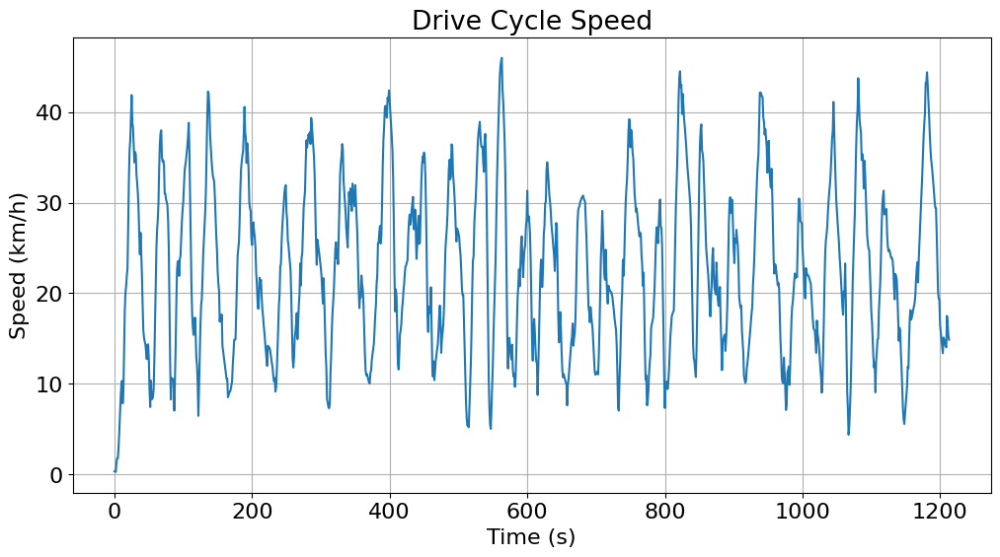

In [ ]:
# prompt: plot df['Speed [km/h]']

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.plot(df['Time [s]'], df['Speed [km/h]'])
plt.xlabel('Time (s)')
plt.ylabel('Speed (km/h)')
plt.title('Drive Cycle Speed')
plt.grid(True)
plt.show()


### 1. Function that wil canculate ForceData required for the starting page

In [ ]:

def dataForce(mass,rho,Cd,Af,g,alpha,r,df):
    df['speed'] = df['Speed']
    df['distance'] = (df['speed'] * df['Time [s]'].diff()).cumsum().fillna(0)
    df['Acceleration'] = df['speed'].diff() / df['Time [s]'].diff()
    df['positiveAcceleration'] = df['Acceleration'].where(df['Acceleration'] >= 0, 0)
    df['angle'] = 0

    # Force due to acceleration
    df['Force_Acceleration'] = mass*df['positiveAcceleration']

    # Force due to drag
    df['Force_Drag'] = 0.5*rho*Af*Cd*(df['speed']**2)

    # Force due to friction
    # Since friction cofficient itself is speed dependent so first we have to calculate the friction cofficient
    df['Friction_Cofficient'] = np.where(df['Speed [km/h]'] <= 0, 0, 0.01*(1+df['Speed [km/h]']/160))
    df['Force_Rolling_Resistance'] = df['Friction_Cofficient']*mass*g*np.cos(np.radians(df['angle']))

    # Force due to its own weight travelling on a gradient
    df['Force_Weight'] = mass*np.sin(np.radians(df['angle']))

    # Total Force at all the instant points

    # Doubt for calculating the all forces We should only consider5 the forces where the acceleration is positive
    # As the vehicle is in braking mode when the acceleration is negative and battery is not providing any energy
    # Total Force at all the instant points

    df['Force_Total'] = df['Force_Weight'] + df['Force_Rolling_Resistance'] + df['Force_Drag'] + df['Force_Acceleration']

    # Force vise power analysdf_force_analysis
    df['Power_Drag'] = df['Force_Drag']*df['speed']
    df['Power_Rolling_Resistance'] = df['Force_Rolling_Resistance']*df['speed']
    df['Power_Drag'] = df['Force_Drag']*df['speed']
    df['Power_Acceleration'] = df['Force_Acceleration']*df['speed']
    df['Power_Total'] = df['Force_Total']*df['speed']


    df['omega'] = df['speed']/r
    df['omega_rpm'] = df['omega']*(60/(2*np.pi))
    df['Torque_Wheel'] = df['Force_Total']*r

    df['Power_Wheels'] = df['Torque_Wheel']*df['omega']
    return df


In [ ]:
def plot_motor_forces(df):
    # Plotting individual forces

    plt.plot(df['Time [s]'], df['Force_Acceleration'], label='Force Acceleration', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Acceleration [N]')
    plt.title('Acceleration Forces Over Time')
    plt.show()
    plt.plot(df['Time [s]'], df['Force_Drag'], label='Force Drag', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Drag [N]')
    plt.title('Drag Forces Over Time')
    plt.show()
    plt.plot(df['Time [s]'], df['Force_Rolling_Resistance'], label='Force Rolling Resistance', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Rolling resistance [N]')
    plt.title('Rolling Forces Over Time')
    plt.show()
    plt.plot(df['Time [s]'], df['Force_Weight'], label='Force Weight', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Weight [N]')
    plt.title('Weight Forces Over Time')
    plt.show()



    # Plotting total force
    plt.figure(figsize=(14, 6))
    plt.plot(df['Time [s]'], df['Force_Total'], color='red', label='Total Force', linestyle=':' )

    plt.xlabel('Time [s]')
    plt.ylabel('Total Force [N]')
    plt.title('Total Force Over Time')
    plt.grid(True)
    plt.legend()
    plt.show()

In [ ]:
def plot_motor_power(df):
    # Plotting individual forces

    plt.plot(df['Time [s]'], df['Force_Acceleration'], label='Force Acceleration', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Acceleration [N]')
    plt.title('Acceleration Forces Over Time')
    plt.show()
    plt.plot(df['Time [s]'], df['Force_Drag'], label='Force Drag', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Drag [N]')
    plt.title('Drag Forces Over Time')
    plt.show()
    plt.plot(df['Time [s]'], df['Force_Rolling_Resistance'], label='Force Rolling Resistance', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Rolling resistance [N]')
    plt.title('Rolling Forces Over Time')
    plt.show()
    plt.plot(df['Time [s]'], df['Force_Weight'], label='Force Weight', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Force Weight [N]')
    plt.title('Weight Forces Over Time')
    plt.show()



    # Plotting total force
    plt.figure(figsize=(14, 6))
    plt.plot(df['Time [s]'], df['Force_Total'], color='red', label='Total Force', linestyle=':' )

    plt.xlabel('Time [s]')
    plt.ylabel('Total Force [N]')
    plt.title('Total Force Over Time')
    plt.grid(True)
    plt.legend()
    plt.show

### 2. Now the series required for the MotorParameters will be calculated here

In [ ]:

def plot_motor_power(df):
    # Plotting individual powers
    plt.plot(df['Time [s]'], df['Power_Acceleration'], label='Power Acceleration', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Power Acceleration [W]')
    plt.title('Acceleration Power Over Time')
    plt.grid(True)
    plt.show()

    plt.plot(df['Time [s]'], df['Power_Drag'], label='Power Drag', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Power Drag [W]')
    plt.title('Drag Power Over Time')
    plt.grid(True)
    plt.show()

    plt.plot(df['Time [s]'], df['Power_Rolling_Resistance'], label='Power Rolling Resistance', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Power Rolling Resistance [W]')
    plt.title('Rolling Resistance Power Over Time')
    plt.grid(True)
    plt.show()

    # Plotting total power
    plt.plot(df['Time [s]'], df['Power_Total'], color='purple', label='Total Power', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Total Power [W]')
    plt.title('Total Power Over Time')
    plt.grid(True)
    plt.show()

    # Plotting power at wheels
    plt.plot(df['Time [s]'], df['Power_Wheels'], color='green', label='Power at Wheels', linestyle=':')
    plt.xlabel('Time [s]')
    plt.ylabel('Power at Wheels [W]')
    plt.title('Power at Wheels Over Time')
    plt.grid(True)
    plt.show()

# Example call to the function with the dataframe containing power calculations
# plot_motor_power(df)


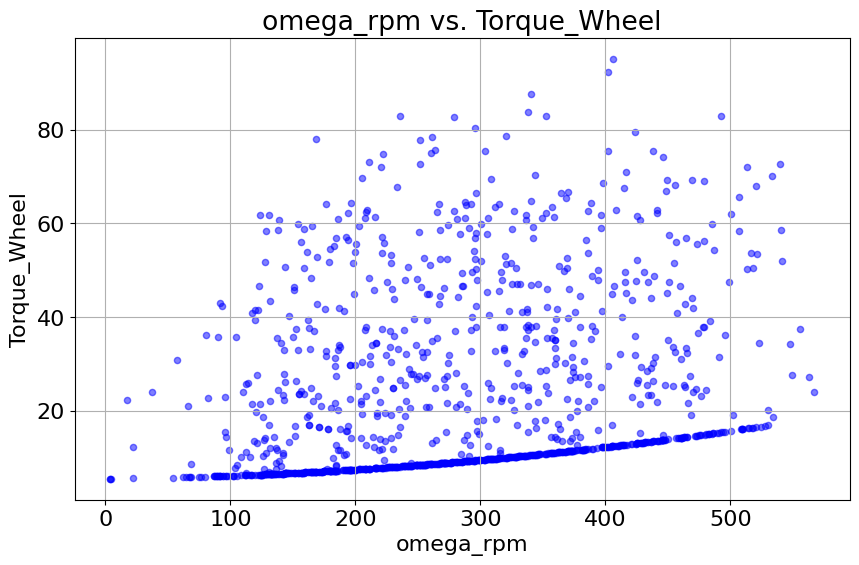

In [ ]:

plt.figure(figsize=(10, 6))
plt.scatter(df['omega_rpm'], df['Torque_Wheel'], s=20, c='blue', alpha=0.5)
plt.xlabel('omega_rpm')
plt.ylabel('Torque_Wheel')
plt.title('omega_rpm vs. Torque_Wheel')
plt.grid(True)
plt.show()


### 3. Motor Parameters are calculated from the dataFrame Here

In [ ]:
def motorParameters(df):
    motorpara = {}
    max_speed = df['Motor_Speed'].max()
    motorpara['max_speed'] = max_speed

    plt.figure(figsize=(10, 6))
    plt.scatter(df['Motor_Speed_rpm'], df['Motor_Torque'])
    plt.xlabel('Motor Speed (RPM)')
    plt.ylabel('Motor Torque (Nm)')
    plt.title('Motor Torque vs Speed')
    plt.grid(True)
    plt.show()


    # Maximum Torque and speed at maximum torque
    max_index = df['Motor_Torque'].idxmax()
    speed_at_peak_torque = df.loc[max_index, 'Motor_Speed_rpm']
    motorpara['speed_at_peak_torque'] = speed_at_peak_torque
    max_torque = df.loc[max_index, 'Motor_Torque']

    # Formulas For the further analysis
    base_speed_for_motor = max_speed/Motor_max_to_base_speed_ratio # Base Speed of the motor in radian per second
    rated_torque_for_motor = max_torque/Motor_overload_factor_for_torque # Max Torque in Nm
    rated_power_of_motor = rated_torque_for_motor*base_speed_for_motor/(1000) # Rated Power of in KW
    peak_power_of_motor = rated_power_of_motor*Motor_overload_factor_power # Peak Power of the motor in KW

    # Motor parameters after the calculations
    motorpara['max_torque'] = max_torque
    motorpara['Motor_overload_factor_for_torque'] = Motor_overload_factor_for_torque
    motorpara['rated_torque_for_motor'] = rated_torque_for_motor
    motorpara['base_speed_for_motor'] = base_speed_for_motor
    motorpara['Motor_max_to_base_speed_ratio'] = Motor_max_to_base_speed_ratio
    motorpara['rated_power_of_motor'] = rated_power_of_motor
    motorpara['peak_power_of_motor'] = peak_power_of_motor


    return motorpara

### 4. Funtion that will calculate the Cyclic Motor efficieny of the motor

In [ ]:
def efficiencyMap():
  return  np.array([
    [0, 0, 0, 0, 0, 0, 0, 0, 0,0],
    [0, 11.6659, 11.6659, 11.6659, 13.7542, 15.8425, 13.7542, 13.7542, 11.6659, 7.4891],
    [0, 61.7851, 70.1393, 76.4042, 80.5809, 80.5809, 80.5809, 80.5809, 80.5809, 78.4926],
    [0, 72.2276, 76.4042, 82.6692, 86.8459, 86.8459, 88.9342, 88.9342, 86.8459, 86.8459],
    [0, 70.1392, 78.4926, 84.7576, 88.9342, 88.9342, 88.9342, 88.9342, 88.9342, 88.9342],
    [0, 68.0506, 76.4042, 84.7576, 86.8459, 88.9342, 88.9342, 88.9342, 88.9342, 88.9342],
    [0, 65.9621, 74.3159, 82.6692, 86.8459, 88.9342, 88.9342, 88.9342, 88.9342, 86.8459],
    [0, 59.6968, 72.2276, 80.5809, 84.7576, 86.8459, 88.9342, 88.9342, 86.8459, 86.8459]
  ])

def cyclicMotorEfficiency(df):
    maximum_speed_rpm = df['Motor_Speed_rpm'].max()
    max_torque = df['Motor_Torque'].max()

    # Define the range of values for speed and torque
    speed = np.linspace(0,maximum_speed_rpm, num=10) # This will reshape the motor speed in rpm [0,maximum_Motor_speed_in_Rpm]
    torque = np.linspace(-10, max_torque, num=8) # This will reshape the motor torque in [-10,max_torque]

    Z = efficiencyMap()

    f = interpolate.interp2d(speed, torque, Z , kind='linear')

    eff = []
    for i in range(len(df['Motor_Speed_rpm'])):
        x = f(df['Motor_Speed_rpm'][i], df['Motor_Torque'][i])
        if x[0] >=10 :
            eff.append(x[0])
        else :
            eff.append(0.1)

    # Create a new Pandas Series object from the eff list
    efficiency = pd.Series(eff, name='efficiency')



    # Add the efficiency column to the df_motor DataFrame
    df = pd.concat([df, efficiency], axis=1)


    return df

### 5. Sereis reqired for the calculation of Battery Parameters are added here in DataFrame

In [ ]:
def batteryParametersData(df):
    cyclicMotorEfficiency = df['efficiency'].mean()
    Cyclic_inverter_efficiency = 1

    df['power_inverter_output'] = df['power_motor_output']*100/df['efficiency']
    df['power_battery_output'] = df['power_inverter_output']/Cyclic_inverter_efficiency
    df['Energy_battery_output'] = df['power_battery_output']*1/3600

    return df

### 6. Now this funtion will calculate all the Battery Parameters

In [ ]:
def batteryParameters(df, range_we_wanted, optimal_c_rate, specific_energy_battery, battery_voltage, battery_utilization):
    batteryPara = {}

    batteryPara['Total_energy_consumed_in_drive_cycle'] = df['Energy_battery_output'].sum()/1000 #Kwhr/km

    Total_distance_of_drive_cycle = df['distance'].iloc[-1]/1000

    batteryPara['Milage'] = batteryPara['Total_energy_consumed_in_drive_cycle']/Total_distance_of_drive_cycle
    batteryPara['battery_size'] = range_we_wanted*  batteryPara['Milage'] # kWhr
    batteryPara['optimal_battery_power'] = batteryPara['battery_size']*optimal_c_rate
    batteryPara['weight_of_the_battery'] = batteryPara['optimal_battery_power']*1000/specific_energy_battery
    batteryPara['battery_Ah'] =  batteryPara['battery_size']*1000/battery_voltage
    batteryPara['usable_Ah'] = batteryPara['battery_Ah']*battery_utilization

    return batteryPara

In [ ]:
mass = 260
rho = 1.22   ## Density of Air
Cd = 0.78   ## Aerodynamic Drag
Af = 0.68   ## frontal area of the vehical
g = 9.81  # graviatational coefficient
alpha=0   # Road Angle
r = 0.215  # radius of wheel in meters

df = dataForce(mass,rho,Cd,Af,g,alpha,r,df)

Motor_overload_factor_power = 1.8
Motor_overload_factor_for_torque = 1.8
Motor_max_to_base_speed_ratio = 1.75

gear_ratio_fixed = 1
gear_efficiency = 0.96

df = DataMotor(Motor_max_to_base_speed_ratio,Motor_overload_factor_power,Motor_overload_factor_for_torque,gear_ratio_fixed,gear_efficiency,df)
motorpara = motorParameters(df)

NameError: name 'DataMotor' is not defined

In [ ]:
motorpara

In [ ]:
df = cyclicMotorEfficiency(df)
df = batteryParametersData(df)

KeyError: 'Motor_Speed_rpm'

In [ ]:
batteryParameters(df, 100, 1, 200, 72, 0.8)